In [1]:
%matplotlib inline
import matplotlib.pyplot as plt
import numpy as np
import obspy
from obspy import UTCDateTime
from obspy.clients.fdsn import Client
from obspy.taup import TauPyModel

# Download Hawaii 2018 Kilauea eruption earthquakes starting at calculated arrival times

### First, download a catalog of events

In [7]:
client = Client('IRIS')

starttime = UTCDateTime('2018-04-01')
endtime = UTCDateTime('2018-8-31')

cat = client.get_events(starttime=starttime, endtime=endtime,
                        latitude=19.365051, longitude=-155.278054, maxradius=1.0,
                        includearrivals=True,
                        minmagnitude=1.5)#, catalog="NEICPDE")

In [8]:
cat

41474 Event(s) in Catalog:
2018-08-30T22:31:16.570000Z | +19.455, -154.854 | 2.52 Ml
2018-08-30T17:22:51.980000Z | +19.976, -155.360 | 2.8 ML
...
2018-04-01T08:09:00.750000Z | +19.418, -155.275 | 1.92 Ml
2018-04-01T06:52:12.630000Z | +19.187, -155.497 | 1.79 Md
To see all events call 'print(CatalogObject.__str__(print_all=True))'

In [20]:
POHA = client.get_stations(network="IU", station="POHA", 
                           starttime=starttime, endtime=endtime,
                          level='response')

In [163]:
from obspy.taup import TauPyModel
from obspy.clients import iris
    
class ArrivalTimeDownloader:
    
    def __init__(self):
        self.taumodel = TauPyModel(model="iasp91")
        self.irisclient = iris.Client()
        self.fsdn_client = Client('IRIS')
        self.ev_list = None
        
    def _calc_arrival_delta(self, event, station, instrument='IU.POHA.00.BHZ'):
        
        coords = station.get_coordinates(instrument)
        stalat, stalong = coords['latitude'], coords['longitude']
        
        evdepth = event.origins[0].depth/1000
        evlat, evlong = (event.origins[0].latitude, event.origins[0].longitude)
        
        delta = int(self.taumodel.get_travel_times_geo(np.abs(evdepth),evlat,evlong,stalat,stalong)[0].time)
        
        return delta
    
    def download_trace(self, event, station, instrument='IU.POHA.00.BHZ', length=40):
        
        delta = self._calc_arrival_delta(event, station, instrument)
        
        starttime = event.origins[0].time + delta
        endtime = starttime + length
        
        tr = self.fsdn_client.get_waveforms(network='IU', station='POHA', location='00',
                               channel='BHZ', starttime=starttime, endtime=endtime,
                               attach_response=True)
        
        return tr
    
    def download_multiple_traces(self, events, station, instrument='IU.POHA.00.BHZ', length=40):
        
        #build the list of waveform requests for bulk download
        ev_list = []
        for i, event in enumerate(events):
            delta = self._calc_arrival_delta(event, station, instrument)
            starttime = event.origins[0].time + delta
            endtime = starttime + length
            
            ev_list.append(('IU', 'POHA', '00', 'BHZ', starttime, endtime))
            if i%1000 == 0:
                print(i)
        
        self.ev_list = ev_list
        
        print('Downloading {} seismograms'.format(len(events)))
            
        stream = self.fsdn_client.get_waveforms_bulk(ev_list, attach_response=True)
        
        return stream
        

In [164]:
arr = ArrivalTimeDownloader()

In [295]:
stream.write("hawaii_Apr-Aug-2018_mag31.5_POHA_waveforms.mseed", format="MSEED") 

In [211]:
stream = obspy.read('hawaii_Apr-Aug-2018_mag31.5_POHA_waveforms.mseed')
stream

33907 Trace(s) in Stream:

IU.POHA.00.BHZ | 2018-04-01T06:52:23.669538Z - 2018-04-01T06:53:03.619538Z | 20.0 Hz, 800 samples
...
(33905 other traces)
...
IU.POHA.00.BHZ | 2018-08-30T22:31:29.619538Z - 2018-08-30T22:32:09.569538Z | 20.0 Hz, 800 samples

[Use "print(Stream.__str__(extended=True))" to print all Traces]

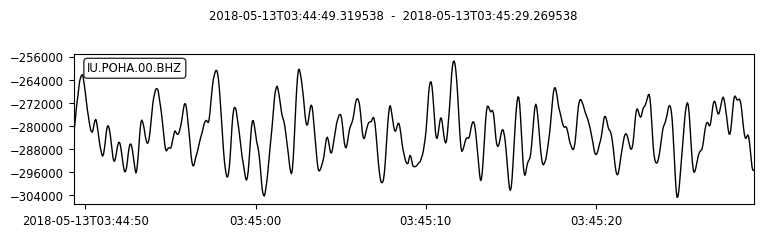

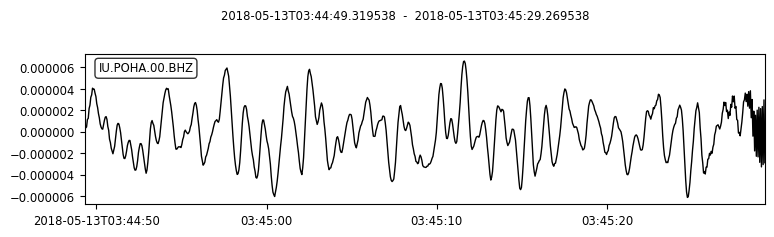

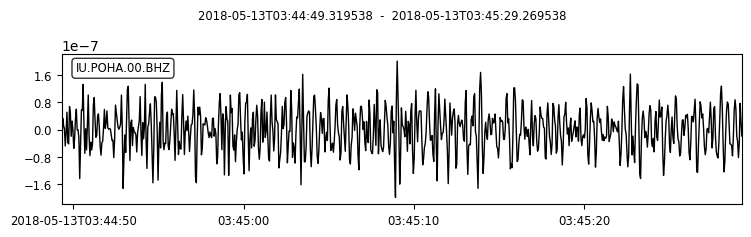

In [242]:
cp = stream[2000].copy()
_=cp.plot()
cp.remove_response(POHA)
_=cp.plot()
cp.filter('bandpass', freqmin=3, freqmax=8, corners=2, zerophase=True)
#cp.filter('highpass', freq=1, corners=2, zerophase=True)
_=cp.plot()

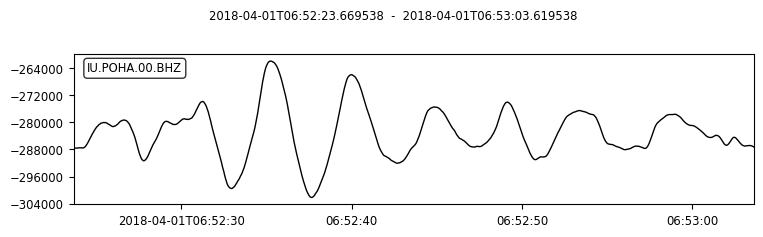

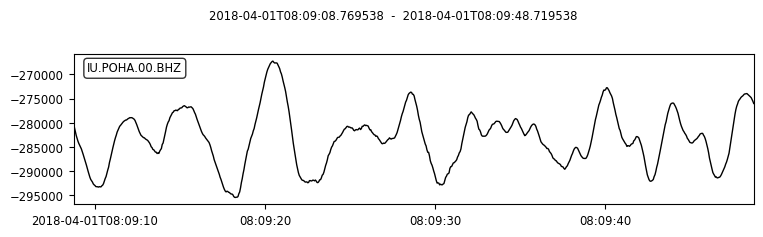

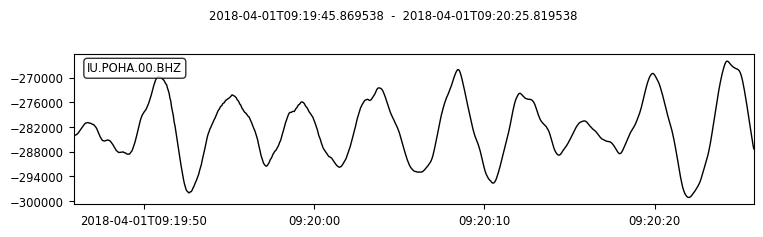

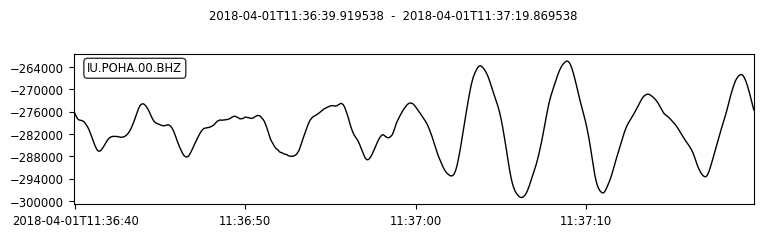

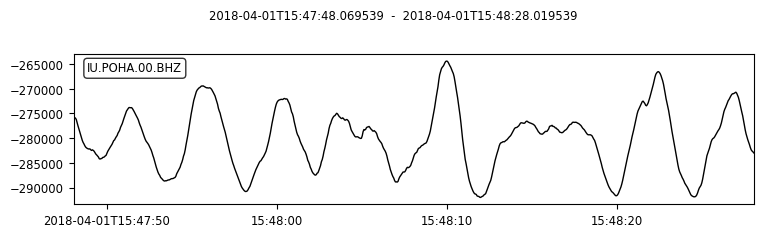

...

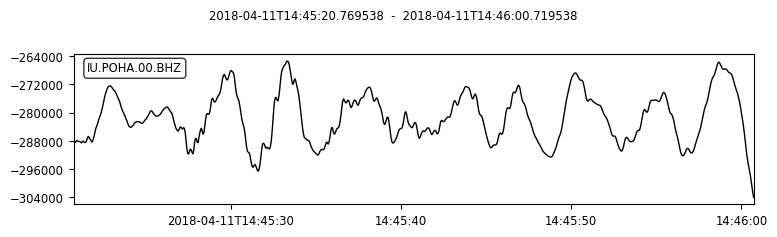

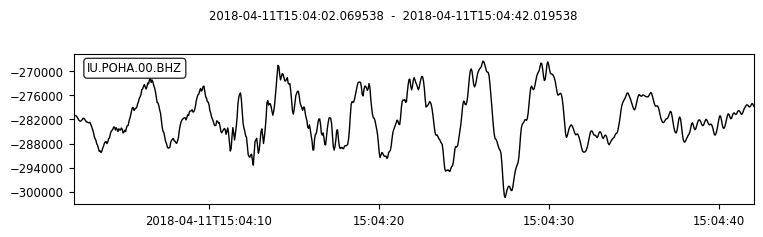

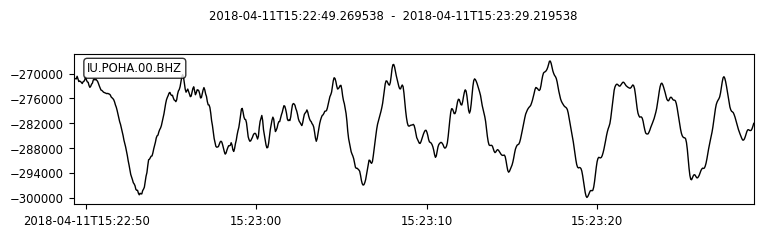

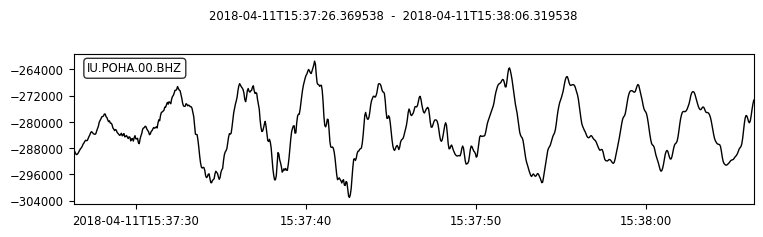

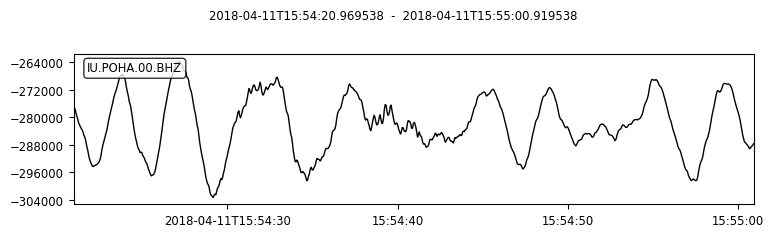

In [174]:
for st in stream[:100]:
    st.plot()

In [209]:
stream.remove_response(POHA)
stream.filter('highpass', freq=1.0, corners=2, zerophase=True)

33907 Trace(s) in Stream:

IU.POHA.00.BHZ | 2018-04-01T06:52:23.669538Z - 2018-04-01T06:53:03.619538Z | 20.0 Hz, 800 samples
...
(33905 other traces)
...
IU.POHA.00.BHZ | 2018-08-30T22:31:29.619538Z - 2018-08-30T22:32:09.569538Z | 20.0 Hz, 800 samples

[Use "print(Stream.__str__(extended=True))" to print all Traces]

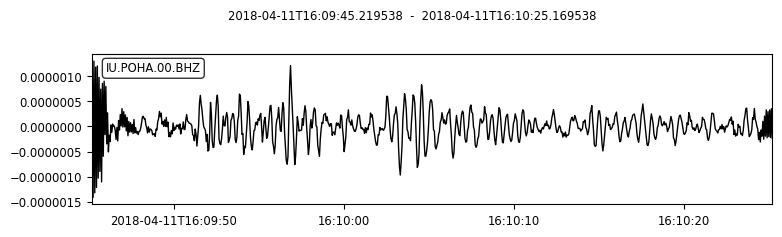

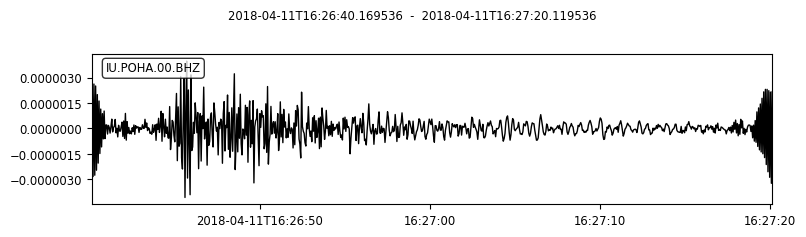

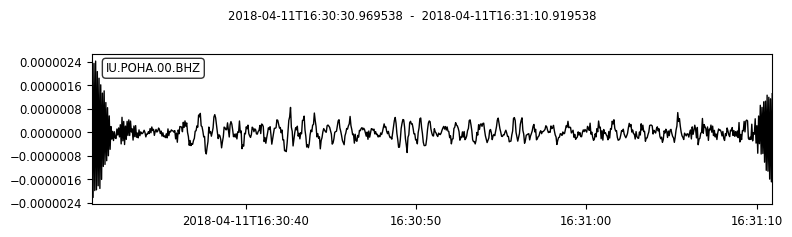

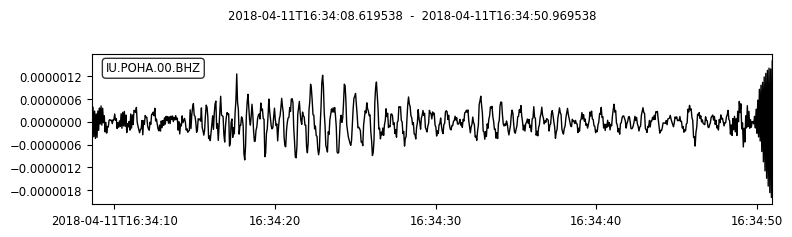

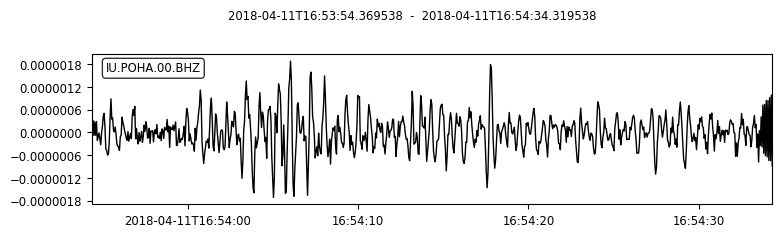

...

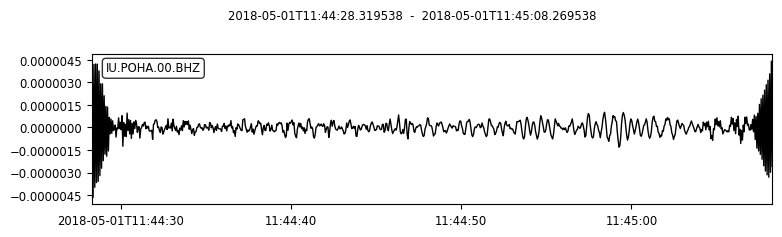

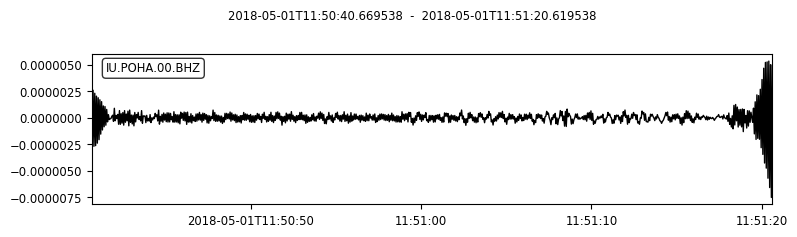

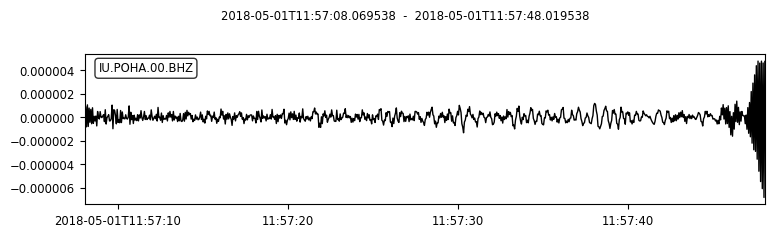

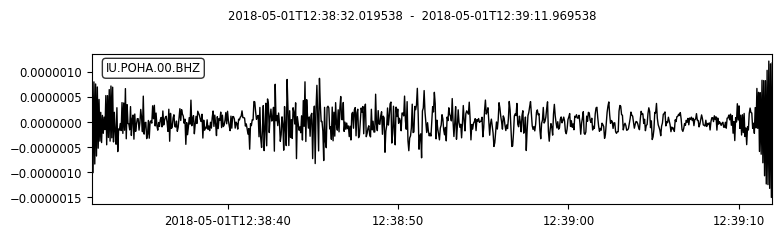

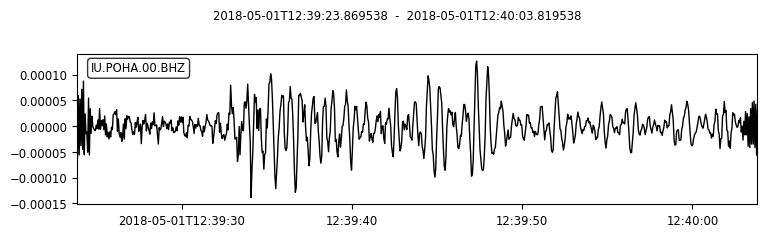

In [210]:
for st in stream[100:500]:
    st.plot()

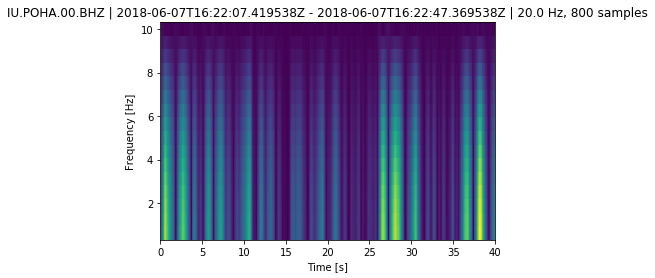

In [260]:
stream[6000].spectrogram()

In [262]:
t = stream[0]

In [283]:
stream[1].meta.starttime 

2018-04-01T08:09:08.769538Z

In [276]:
cat[2].origins[0]

Origin
	   resource_id: ResourceIdentifier(id="smi:service.iris.edu/fdsnws/event/1/query?originid=34308686")
	          time: UTCDateTime(2018, 8, 30, 15, 26, 45, 430000)
	     longitude: -155.200333
	      latitude: 19.328833
	         depth: -130.0
	 creation_info: CreationInfo(author='hv')

In [287]:
net, sta, loc, ch, st, end = arr.ev_list[0]


In [288]:
client.get_waveforms(net,sta,loc,ch,st,end)

1 Trace(s) in Stream:
IU.POHA.00.BHZ | 2018-08-30T22:31:29.619538Z - 2018-08-30T22:32:09.569538Z | 20.0 Hz, 800 samples

In [ ]:
stream = obspy.Stream()
i=0

for ev in arr.ev_list:
    net, sta, loc, ch, st, end = ev
    stream += client.get_waveforms(net,sta,loc,ch,st,end)
    if i%100 == 0:
        print(i)
    i += 1

In [297]:
stream

41474 Trace(s) in Stream:

IU.POHA.00.BHZ | 2018-08-30T22:31:29.619538Z - 2018-08-30T22:32:09.569538Z | 20.0 Hz, 800 samples
...
(41472 other traces)
...
IU.POHA.00.BHZ | 2018-04-01T06:52:23.669538Z - 2018-04-01T06:53:03.619538Z | 20.0 Hz, 800 samples

[Use "print(Stream.__str__(extended=True))" to print all Traces]

In [299]:
cat.write()
